In [19]:
import pandas as pd
import numpy as np
import os
import re
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# 데이터 전처리

## No Seal

In [88]:
folder_path = 'D:/data/No Seal'
file_list = os.listdir('D:/data/No Seal')
ab_file = file_list

df_ab = []
df = pd.DataFrame()

for i in range(len(file_list)):
    
    #파일 불러오기
    file_path = os.path.join(folder_path, file_list[i]) 
    df_file = pd.read_csv(file_path, sep='\t', skiprows=range(9))
    
    #필요없는 변수 제거 및 전처리
    df_file = df_file.shift(1, axis=1)
    df_file.drop(['      No','Position #2', 'Velocity #2', '   NFLow'], axis=1, inplace=True) #불필요 변수 제거
    df_file['Position #1'] = - df_file['Position #1'] + abs(df_file['Position #1'].max()) # Position 변수 전처리
    df_file['Velocity #1'] = - df_file['Velocity #1']
    
    # 파일 이름에서 HC, RC, Unit 값을 추출
    file_name = file_list[i]
    hc_value = re.search(r'HC([\d.]+)', file_name).group(1)
    rc_value = re.search(r'RC([\d.]+)', file_name).group(1)
    unit_value = re.search(r'Unit([\d.]+)', file_name).group(1)
    
    # HC와 RC 값을 데이터프레임에 추가
    df_file['HC'] = float(hc_value)
    df_file['RC'] = float(rc_value)
    df_file['Unit'] = float(unit_value)    
    
    #같은 조건 파일끼리 합치기
    df = pd.concat([df, df_file])    
    
    if i + 1 == len(file_list) or file_list[i + 1].endswith('_0.xls'):
        df_ab.append(df)
        df = pd.DataFrame()        

In [110]:
ab_list = []

for i in range(len(df_ab)):
    abnor = df_ab[i].copy()
    cut = (abnor['Position #1'] < 1).idxmax()

    abnor = abnor[cut:].reset_index(drop=True)
    
    abnor['dir'] = np.where(abnor['Velocity #1'] >= 0.01, 1,
                                np.where(abnor['Velocity #1'] <= -0.01, 0, np.nan))

    abnor['dir'] = abnor['dir'].ffill()
    abnor.loc[0, 'dir'] = 0
    
    len_df = len(abnor)
    
    for k in range(1, len_df):
        if abs(abnor.loc[k, 'Velocity #1'] - abnor.loc[k - 1, 'Velocity #1']) < 0.05:
            abnor.loc[k, 'dir'] = abnor.loc[k - 1, 'dir']
        
    abnor['Flow(F)'] = np.where(abnor['dir'] == 1, abnor[' Flow(F)'] * 1,
                                   np.where(abnor['dir'] == 0, abnor[' Flow(F)'] * -1, np.nan))
    
    abnor['Flow(B)'] = np.where(abnor['dir'] == 0, abnor[' Flow(B)'] * 1,
                                   np.where(abnor['dir'] == 1, abnor[' Flow(B)'] * -1, np.nan))
    ab_list.append(abnor)

In [97]:
ab_list[0]

,Time (sec),Position #1,Flow(F),Flow(B),Vibration,Press(F),Press(B),NPress #1,NPress #2,Temp(F),Temp(B),Velocity #1,HC,RC,Unit,dir,Flow(F),Flow(B)
0,141.20,0.96,21.10,25.36,1.45,66.03,0.16,-0.81,10.53,36.35,34.39,-0.05,17.5,17.5,75.0,0,-21.10,25.36
1,141.21,0.94,20.92,25.09,1.47,66.06,0.17,-0.81,10.47,36.35,34.39,-0.04,17.5,17.5,75.0,0,-20.92,25.09
2,141.22,0.92,20.74,24.81,1.47,66.10,0.18,-0.81,10.43,36.35,34.39,-0.03,17.5,17.5,75.0,0,-20.74,24.81
3,141.23,0.91,20.56,24.55,1.48,66.14,0.19,-0.80,10.39,36.34,34.40,-0.02,17.5,17.5,75.0,0,-20.56,24.55
4,141.24,0.90,20.39,24.29,1.47,66.17,0.21,-0.80,10.35,36.34,34.40,-0.01,17.5,17.5,75.0,0,-20.39,24.29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
389325,4034.45,464.06,0.54,0.33,-0.05,1.58,-1.81,-0.06,0.45,49.54,49.81,0.00,17.5,17.5,75.0,1,0.54,-0.33
389326,4034.46,464.08,0.53,0.33,-0.05,1.61,-1.79,-0.06,0.45,49.52,49.81,0.00,17.5,17.5,75.0,1,0.53,-0.33
389327,4034.47,464.09,0.53,0.32,-0.05,1.64,-1.78,-0.06,0.45,49.50,49.81,0.00,17.5,17.5,75.0,1,0.53,-0.32
389328,4034.48,464.10,0.53,0.32,-0.05,1.66,-1.77,-0.06,0.44,49.49,49.81,0.00,17.5,17.5,75.0,1,0.53,-0.32


In [6]:
ab_file

['No_Seal_HC17.5_RC17.5_Unit75_100Hz_230721_090648_0.xls',
 'No_Seal_HC17.5_RC17.5_Unit75_100Hz_230721_094615_1.xls',
 'No_Seal_HC35_RC35_Unit150_100Hz_230720_215639_0.xls',
 'No_Seal_HC35_RC35_Unit150_100Hz_230720_223607_1.xls',
 'No_Seal_HC47.5_RC47.5_Unit230_100Hz_230720_202955_0.xls',
 'No_Seal_HC47.5_RC47.5_Unit230_100Hz_230720_210922_1.xls',
 'No_Seal_HC5.7_RC8.5_Unit50_100Hz_230721_111511_0.xls',
 'No_Seal_HC5.7_RC8.5_Unit50_100Hz_230721_115438_1.xls',
 'No_Seal_HC5.7_RC8.5_Unit50_100Hz_230721_123405_2.xls',
 'No_Seal_HC52.5_RC52.5_Unit230_100Hz_230721_072317_0.xls',
 'No_Seal_HC70_RC70_Unit230_100Hz_230720_190347_0.xls',
 'No_Seal_HC70_RC70_Unit230_100Hz_230720_194315_1.xls',
 'No_Seal_HC70_RC70_Unit230_30Hz_230720_170850_0.xls']

## Normal

In [52]:
folder_path = 'D:/data/Normal'
file_list = os.listdir('D:/data/Normal')
nor_file = file_list

df_nor = []
df = pd.DataFrame()

for i in range(len(file_list)):
    
    #파일 불러오기
    file_path = os.path.join(folder_path, file_list[i]) 
    df_file = pd.read_csv(file_path, sep='\t', skiprows=range(9))
    
    #필요없는 변수 제거 및 전처리
    df_file = df_file.shift(1, axis=1)
    df_file.drop(['      No','Position #2', 'Velocity #2', '   NFLow'], axis=1, inplace=True) #불필요 변수 제거
    df_file['Position #1'] = - df_file['Position #1'] + abs(df_file['Position #1'].max()) # Position 변수 전처리
    df_file['Velocity #1'] = - df_file['Velocity #1']
    
    # 파일 이름에서 HC, RC, Unit 값을 추출
    file_name = file_list[i]
    hc_value = re.search(r'HC([\d.]+)', file_name).group(1)
    rc_value = re.search(r'RC([\d.]+)', file_name).group(1)
    unit_value = re.search(r'Unit([\d.]+)', file_name).group(1)
    
    # HC와 RC 값을 데이터프레임에 추가
    df_file['HC'] = float(hc_value)
    df_file['RC'] = float(rc_value)
    df_file['Unit'] = float(unit_value)    
    
    #같은 조건 파일끼리 합치기
    df = pd.concat([df, df_file])    
    
    if i + 1 == len(file_list) or file_list[i + 1].endswith('_0.xls'):
        df_nor.append(df)
        df = pd.DataFrame()        

In [112]:
nor_list = []

for i in range(len(df_nor)):
    nor = df_nor[i].copy()
    cut = (nor['Position #1'] < 1).idxmax()

    nor = nor[cut:].reset_index(drop=True)
    
    nor['dir'] = np.where(nor['Velocity #1'] >= 0.01, 1,
                                np.where(nor['Velocity #1'] <= -0.01, 0, np.nan))

    nor['dir'] = nor['dir'].ffill()
    nor.loc[0, 'dir'] = 0
    
    len_df = len(nor)
    
    for k in range(1, len_df):
        if abs(nor.loc[k, 'Velocity #1'] - nor.loc[k - 1, 'Velocity #1']) < 0.05:
            nor.loc[k, 'dir'] = nor.loc[k - 1, 'dir']
        
    nor['Flow(F)'] = np.where(nor['dir'] == 1, nor[' Flow(F)'] * 1,
                                   np.where(nor['dir'] == 0, nor[' Flow(F)'] * -1, np.nan))
    
    nor['Flow(B)'] = np.where(nor['dir'] == 0, nor[' Flow(B)'] * 1,
                                   np.where(nor['dir'] == 1, nor[' Flow(B)'] * -1, np.nan))
    nor_list.append(nor)

# 시각화

## 정상과 비정상 데이터 비교

In [14]:
num = [(0,1), (2,1), (3,4), (4,5)]

In [15]:
col_list = df_nor[0].columns

In [16]:
df_nor[0].columns

Index(['Time (sec)', 'Position #1', ' Flow(F)', ' Flow(B)', 'Vibration',
       'Press(F)', 'Press(B)', 'NPress #1', 'NPress #2', ' Temp(F)',
       ' Temp(B)', 'Velocity #1', 'HC', 'RC', 'Unit', 'dir', 'Flow(F)',
       'Flow(B)'],
      dtype='object')

for i,k in num:
    df = df_nor[i][:20000]
    df2 = df_ab[k][:20000]
    
    for j in [1,4, 11]:

        fig2 = make_subplots(rows=1, cols=1)
        fig2.add_trace(
            go.Scatter(x=df['Time (sec)'], y=df[col_list[j]], mode='lines', name=df.columns[j])
        )
        fig2.show()

        fig2 = make_subplots(rows=1, cols=1)
        fig2.add_trace(
            go.Scatter(x=df2['Time (sec)'], y=df2[col_list[j]], mode='lines', name=df.columns[j])
        )
        fig2.show()

    for h in [16, 5, 7, 9]:

        fig2 = make_subplots(rows=1, cols=1)
        fig2.add_trace(
            go.Scatter(x=df['Time (sec)'], y=df[col_list[h]], mode='lines', name=df.columns[h])
        )
        fig2.add_trace(
        go.Scatter(x=df['Time (sec)'], y=df[col_list[h+1]], mode='lines', name=df.columns[h+1])
        )
        fig2.show()

        fig2 = make_subplots(rows=1, cols=1)
        fig2.add_trace(
            go.Scatter(x=df2['Time (sec)'], y=df2[col_list[h]], mode='lines', name=df2.columns[h])
        )
        fig2.add_trace(
        go.Scatter(x=df2['Time (sec)'], y=df2[col_list[h+1]], mode='lines', name=df2.columns[h+1])
        )    
        fig2.show()

## 정상데이터 확인

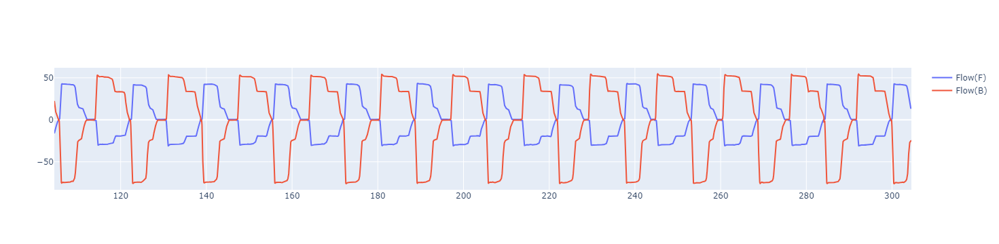

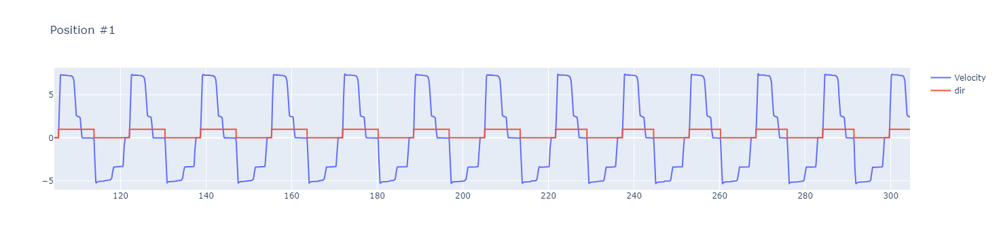

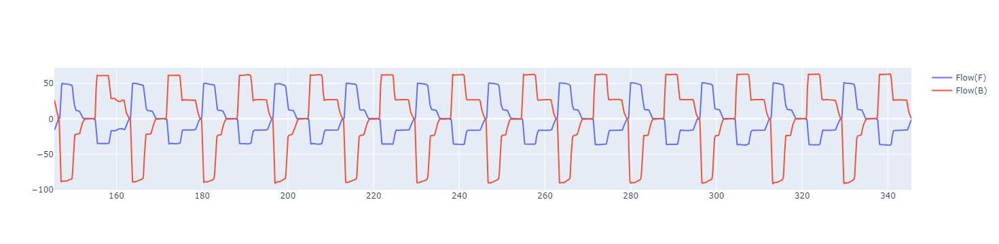

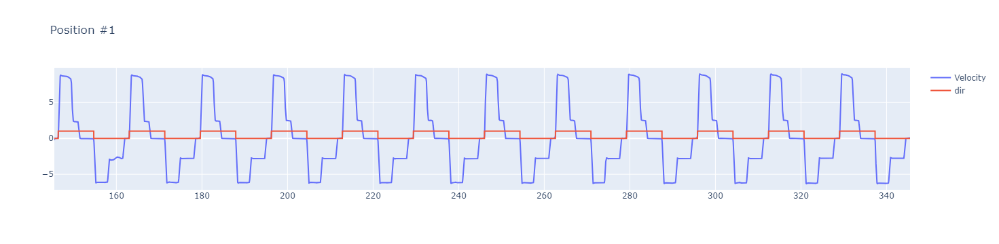

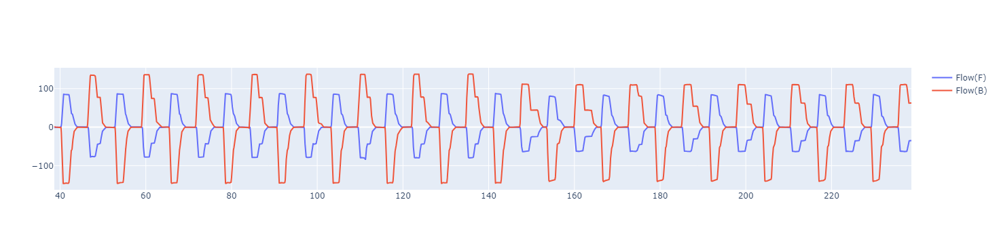

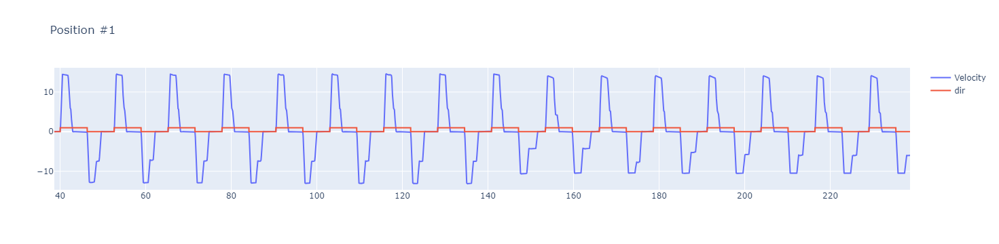

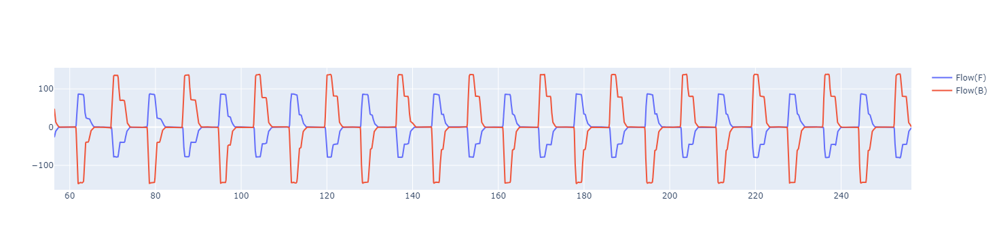

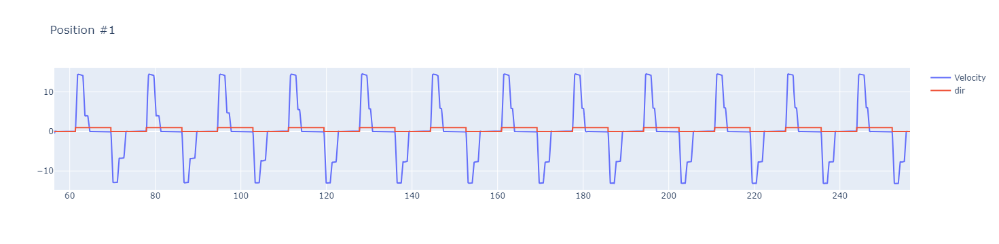

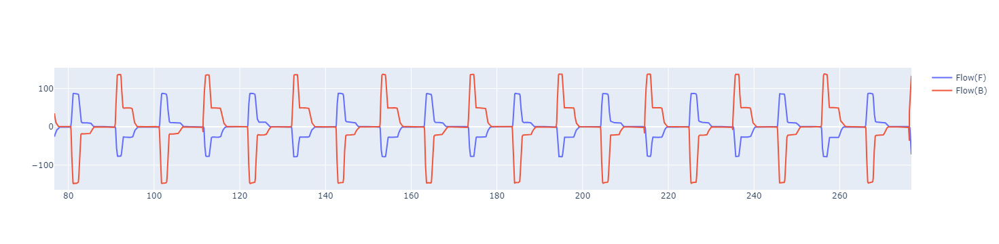

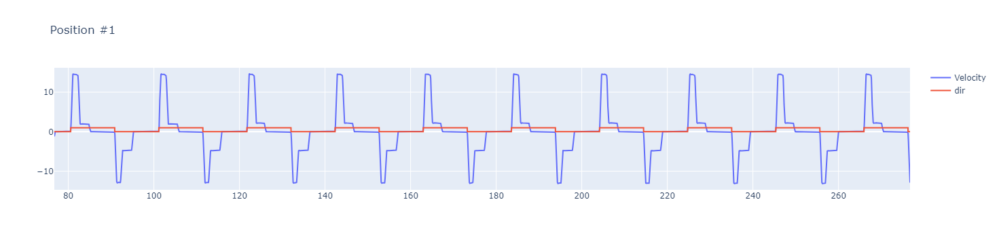

In [113]:
for i in range(len(df_nor)):
    df = nor_list[i][:20000]
    
    fig2 = make_subplots(rows=1, cols=2)
    fig2 = go.Figure()
    fig2.add_trace(
        go.Scatter(x=df['Time (sec)'], y=df['Flow(F)'], mode='lines', name='Flow(F)')
    )    
    fig2.add_trace(
        go.Scatter(x=df['Time (sec)'], y=df['Flow(B)'], mode='lines', name='Flow(B)')
    )   
    fig2.show()    

    
    
    fig2 = make_subplots(rows=1, cols=2)
    fig2 = go.Figure()
    fig2.add_trace(
        go.Scatter(x=df['Time (sec)'], y=df['Velocity #1'], mode='lines', name='Velocity')
    )
    fig2.add_trace(
        go.Scatter(x=df['Time (sec)'], y=df['dir'], mode='lines', name='dir')
    )    
    fig2.update_layout(title_text='Position #1')
    fig2.show()

## 비정상데이터 확인

In [26]:
df_ab[0].columns

Index(['Time (sec)', 'Position #1', ' Flow(F)', ' Flow(B)', 'Vibration',
       'Press(F)', 'Press(B)', 'NPress #1', 'NPress #2', ' Temp(F)',
       ' Temp(B)', 'Velocity #1', 'HC', 'RC', 'Unit'],
      dtype='object')

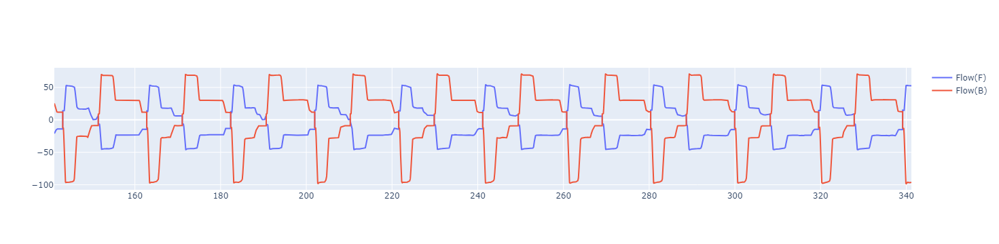

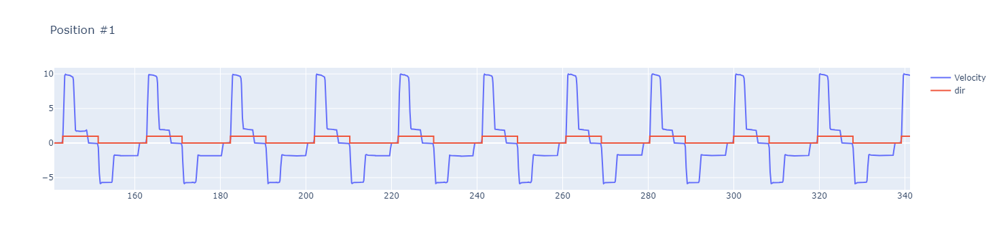

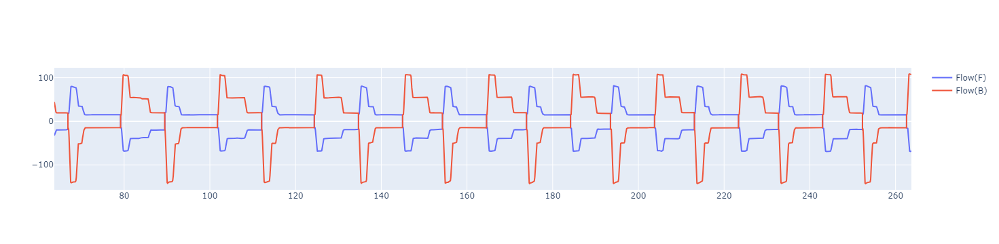

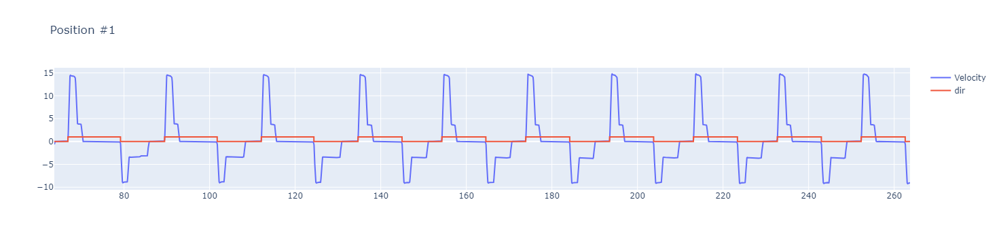

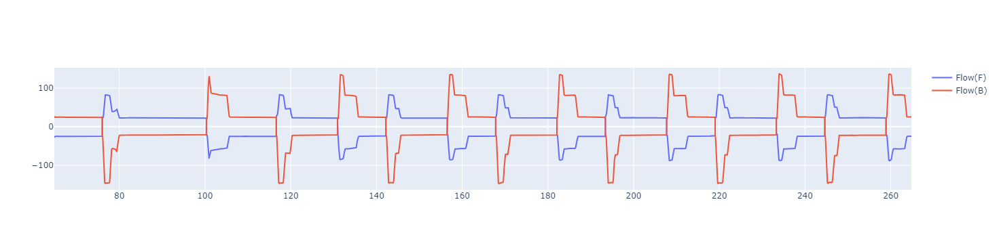

...

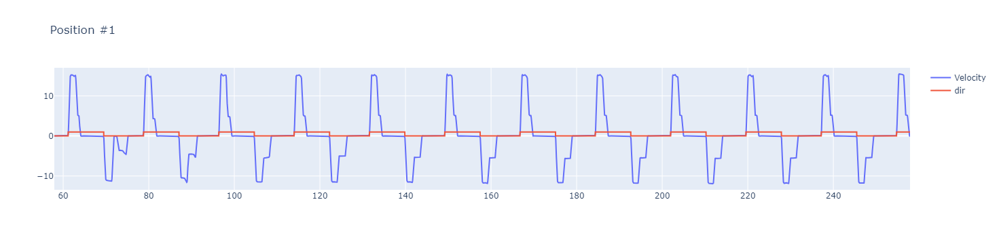

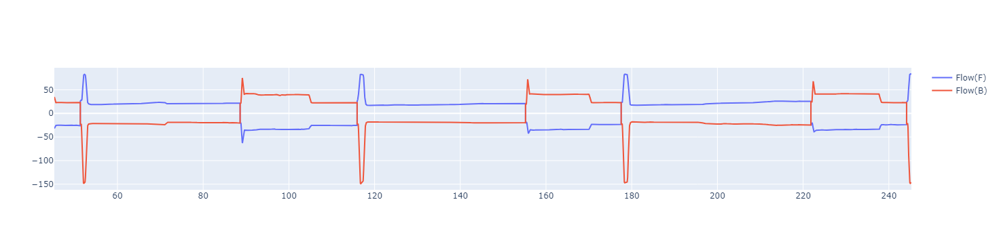

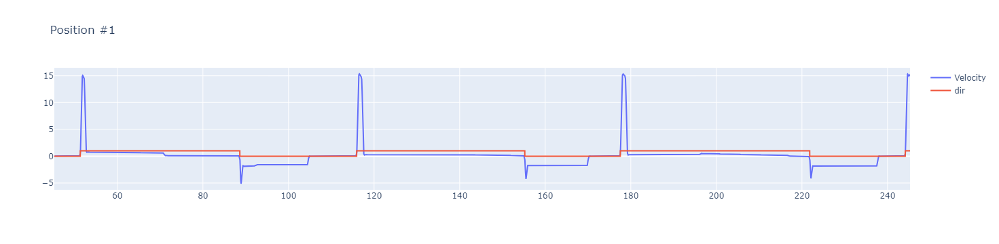

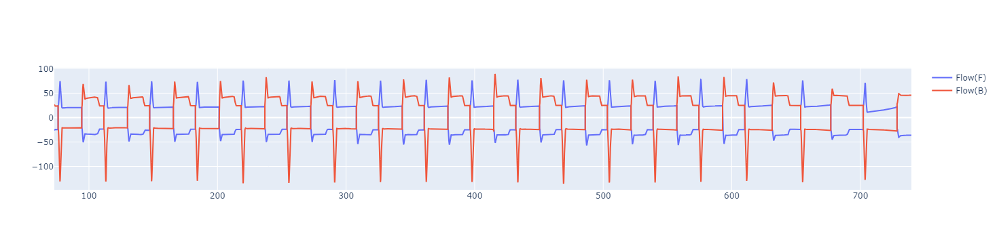

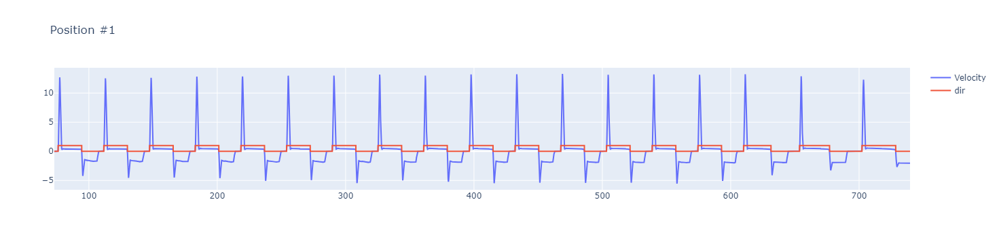

In [114]:
for i in range(len(ab_list)):
    df = ab_list[i][:20000]
    
    fig2 = make_subplots(rows=1, cols=2)
    fig2 = go.Figure()
    fig2.add_trace(
        go.Scatter(x=df['Time (sec)'], y=df['Flow(F)'], mode='lines', name='Flow(F)')
    )    
    fig2.add_trace(
        go.Scatter(x=df['Time (sec)'], y=df['Flow(B)'], mode='lines', name='Flow(B)')
    )   
    fig2.show()    

    
    
    fig2 = make_subplots(rows=1, cols=2)
    fig2 = go.Figure()
    fig2.add_trace(
        go.Scatter(x=df['Time (sec)'], y=df['Velocity #1'], mode='lines', name='Velocity')
    )
    fig2.add_trace(
        go.Scatter(x=df['Time (sec)'], y=df['dir'], mode='lines', name='dir')
    )    
    fig2.update_layout(title_text='Position #1')
    fig2.show()